In [1]:
import pandas as pd
import matplotlib.pyplot as plt

In [2]:
#pip install pandas_ta

In [3]:
import pandas_ta as ta

In [4]:
import random
import math
import os
import torch
import torch.nn as nn
import torch.optim as optim
import numpy as np
from torch.utils.data import Dataset, DataLoader
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import MinMaxScaler

In [5]:
# Everything concerning USDTRY pair is done here, after testing the models CHECK THIS PART!
bist_daily = pd.read_csv("datasets/bist_100_daily.csv")
usdtry_daily = pd.read_csv('datasets/USDTRY_daily.csv')
usdtry_daily = usdtry_daily[["Date","USDTRY_Close"]]
usdtry_daily["Date"]=pd.to_datetime(usdtry_daily["Date"])
bist_daily["Date"] = pd.to_datetime(bist_daily["Date"])
bist_daily = bist_daily.merge(usdtry_daily, how='inner',on="Date")


# Extract the number of rows and columns by using the shape of the data.
numRows,numColumns = bist_daily.shape
# Extract the time interval.
last_date, first_date = bist_daily.iloc[0].Date, bist_daily.iloc[-1].Date
# Check the availability of the data.
na_cols = bist_daily.columns[bist_daily.isna().any()].tolist()

# Print the information.
print(f"There are {numRows} rows and {numColumns} columns in the initial dataset.")
print(f"The data represents the time frame between the dates '{last_date}' and '{first_date}'.")
if not na_cols:
    print("There are no NA rows.")
else:
    print(f"Columns in the dataset which include NA rows: {na_cols}.")
# Convert columns to numeric values
column_names = ["Price", "Open", "High", "Low"]
for column in column_names:
    bist_daily[column] = bist_daily[column].str.replace(',', '')
    bist_daily[column] = pd.to_numeric(bist_daily[column])
# CONVERT TO DATETIME FORMAT AND SORT DATA BY DATE
bist_daily.Date = pd.to_datetime(bist_daily.Date)
bist_daily.sort_values(by="Date", ignore_index=True,inplace=True)
bist_daily.set_index(pd.DatetimeIndex(bist_daily["Date"]), inplace=True)
bist_daily.rename(columns={"Price": "close"},inplace=True)
# Calculate Returns and append to the df DataFrame
# CUMLOGRET_1 and CUMPCTRET_1 are added (NaN values exists)
bist_daily.ta.log_return(cumulative=True, append=True)
bist_daily.ta.percent_return(cumulative=True, append=True)
# Returns a list of indicators and utility functions (to check in future)
ind_list = bist_daily.ta.indicators(as_list=True)
# RSI_14, MACD_12_26_9, MACDh_12_26_9 and MACDs_12_26_9 are added (NaN values exists)
bist_daily.ta.rsi(append=True)
bist_daily.ta.macd(append=True)
# SMA values are added (use ta in the future)
sma_values = [5, 10, 15] 
for i in sma_values:
    bist_daily['SMA'+str(i)] = bist_daily['close'].rolling(window=i).mean()
# Remove all NaN value rows
bist_daily.dropna(inplace=True)
bist_daily

There are 4285 rows and 8 columns in the initial dataset.
The data represents the time frame between the dates '2019-12-02 00:00:00' and '2000-01-05 00:00:00'.
There are no NA rows.


,date,close,open,high,low,Vol.,Change %,USDTRY_Close,CUMLOGRET_1,CUMPCTRET_1,RSI_14,MACD_12_26_9,MACDh_12_26_9,MACDs_12_26_9,SMA5,SMA10,SMA15
date,,,,,,,,,,,,,,,,,
2000-02-29,2000-02-29,159.46,153.15,159.46,151.12,38.20M,4.12%,"0,5743",-0.059997,-0.031662,50.482972,-7.536726,2.021502,-9.558229,149.956,150.081,152.436667
2000-03-02,2000-03-02,169.40,171.99,174.08,166.83,60.08M,-1.51%,"0,5592",0.000472,0.030673,57.007643,-5.687707,3.096417,-8.784124,156.942,151.187,153.030000
2000-03-03,2000-03-03,167.84,169.40,170.67,163.96,53.29M,-0.92%,"0,5771",-0.008779,0.021464,55.765721,-4.298673,3.588361,-7.887034,161.206,152.629,153.666000
2000-03-07,2000-03-07,172.23,165.63,172.23,163.13,33.31M,3.98%,"0,6214",0.017040,0.047620,58.505269,-2.811211,4.060658,-6.871869,164.416,154.488,154.749333
2000-03-08,2000-03-08,173.44,172.23,175.01,169.28,44.39M,0.70%,"0,6420",0.024041,0.054646,59.254312,-1.517260,4.283688,-5.800948,168.474,157.263,156.154000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2019-08-01,2019-08-01,1019.00,1013.42,1021.83,1010.93,1.04B,-0.18%,"5,4811",1.794787,2.848509,56.453510,-2.625148,0.532934,-3.158082,983.092,961.746,988.730667
2019-08-02,2019-08-02,996.79,1015.08,1017.07,996.30,970.54M,-2.18%,"5,2474",1.772750,2.826713,51.628336,-1.558935,1.279317,-2.838253,1001.758,967.324,985.630000
2019-10-01,2019-10-01,1038.77,1052.75,1052.97,1031.89,1.81B,-1.10%,"5,4168",1.814002,2.868828,58.796876,2.643014,4.385014,-1.741999,1010.040,977.668,984.826667


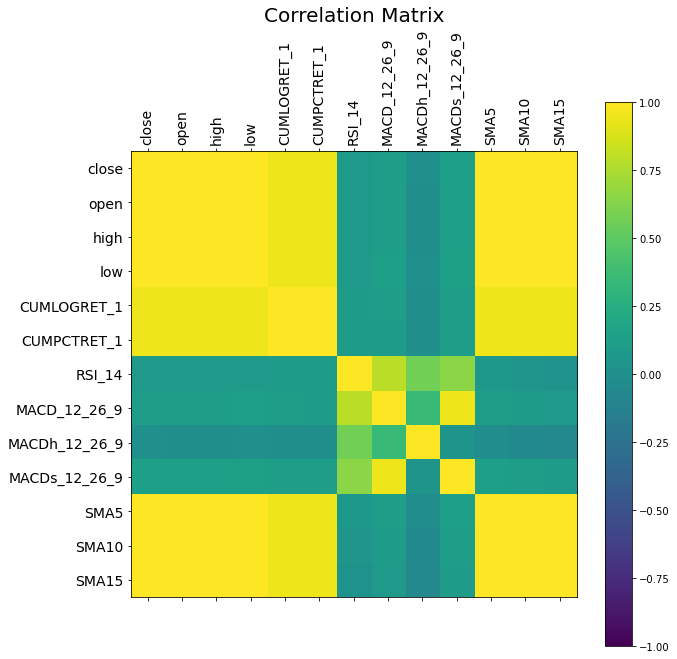

In [6]:
# Visualize the correlation matrix.
fig = plt.figure(figsize=(10,10)) 
ax = fig.add_subplot(111) # 1x1 grid, first subplot.
fig.colorbar(ax.matshow(bist_daily.corr(), vmin=-1, vmax=1)) 
ticks = np.arange(len(bist_daily.corr().columns))
ax.tick_params(axis='x', which='major', labelsize=14, rotation=90)
ax.tick_params(axis='y', which='major', labelsize=14, rotation=0)
ax.set_xticks(ticks)
ax.set_yticks(ticks)
ax.set_xticklabels(bist_daily.corr().columns)
ax.set_yticklabels(bist_daily.corr().columns)
plt.title("Correlation Matrix", fontsize=20)
plt.show()

{1: 2938, 2: 308, 3: 775, 4: 125, 5: 64, 6: 15, 7: 10, 10: 3, 11: 3, 12: 2, 28: 1, 29: 2, 31: 4, 60: 1}


<BarContainer object of 14 artists>

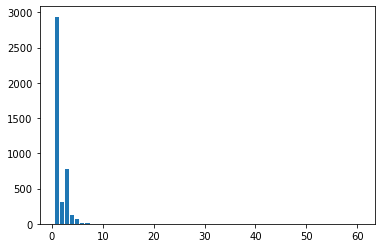

In [7]:
diff = [] 
for date1, date2 in zip(bist_daily["date"][:-1], bist_daily["date"][1:]): 
    diff.append((date2-date1).days) 
unique, counts = np.unique(np.asarray(diff), return_counts=True) 
count_dict = dict(zip(unique, counts)) 
print(count_dict) 
plt.bar(unique,counts)

In [8]:
# edit Vol. column

from operator import itemgetter

vols = bist_daily['Vol.'].to_list()
#[vol[-1] for vol in vols]
#list(filter(lambda vol: "-" in vol,enumerate(vols)))

indexToRemove = bist_daily.iloc[list(map(itemgetter(0),filter(lambda vol: "-" in vol,enumerate(vols))))].index
bist_daily.drop(indexToRemove,inplace=True)
bist_daily['Vol.'] = bist_daily['Vol.'].apply(
    lambda x: float(x[:-1])*(10**6) if x[-1]=="M" else (float(x[:-1])*(10**9) if x[-1]=="B" else "ERROR")).astype("int")
bist_daily

,date,close,open,high,low,Vol.,Change %,USDTRY_Close,CUMLOGRET_1,CUMPCTRET_1,RSI_14,MACD_12_26_9,MACDh_12_26_9,MACDs_12_26_9,SMA5,SMA10,SMA15
date,,,,,,,,,,,,,,,,,
2000-02-29,2000-02-29,159.46,153.15,159.46,151.12,38200000,4.12%,"0,5743",-0.059997,-0.031662,50.482972,-7.536726,2.021502,-9.558229,149.956,150.081,152.436667
2000-03-02,2000-03-02,169.40,171.99,174.08,166.83,60080000,-1.51%,"0,5592",0.000472,0.030673,57.007643,-5.687707,3.096417,-8.784124,156.942,151.187,153.030000
2000-03-03,2000-03-03,167.84,169.40,170.67,163.96,53290000,-0.92%,"0,5771",-0.008779,0.021464,55.765721,-4.298673,3.588361,-7.887034,161.206,152.629,153.666000
2000-03-07,2000-03-07,172.23,165.63,172.23,163.13,33310000,3.98%,"0,6214",0.017040,0.047620,58.505269,-2.811211,4.060658,-6.871869,164.416,154.488,154.749333
2000-03-08,2000-03-08,173.44,172.23,175.01,169.28,44390000,0.70%,"0,6420",0.024041,0.054646,59.254312,-1.517260,4.283688,-5.800948,168.474,157.263,156.154000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2019-08-01,2019-08-01,1019.00,1013.42,1021.83,1010.93,1040000000,-0.18%,"5,4811",1.794787,2.848509,56.453510,-2.625148,0.532934,-3.158082,983.092,961.746,988.730667
2019-08-02,2019-08-02,996.79,1015.08,1017.07,996.30,970540000,-2.18%,"5,2474",1.772750,2.826713,51.628336,-1.558935,1.279317,-2.838253,1001.758,967.324,985.630000
2019-10-01,2019-10-01,1038.77,1052.75,1052.97,1031.89,1810000000,-1.10%,"5,4168",1.814002,2.868828,58.796876,2.643014,4.385014,-1.741999,1010.040,977.668,984.826667


In [9]:
# seeding an arbitrary number to get same results in multiple runs
manualSeed = 999
random.seed(manualSeed)
torch.manual_seed(manualSeed)
print("Seed:", manualSeed)

Seed: 999


In [10]:
# getting number of GPUs from cuda
ngpu = torch.cuda.device_count()
print("Count of available GPUs:", ngpu)

Count of available GPUs: 1


In [11]:
# printing the name of available GPUs
for i in range(ngpu):
    print("GPU {}: {}".format(i+1, torch.cuda.get_device_name(i)))

GPU 1: GeForce RTX 2060


In [12]:
# batch size for the training
batch_size = 64

# optimizer rates
optimizer_betas = (0.9, 0.999)
learning_rate = 5.125e-4

# number of epochs
num_epochs = 100000

# evaluate after evaluation_epoch_num epochs
evaluation_epoch_num = 500

# decide which device we want to run on
device = torch.device("cuda:0" if (torch.cuda.is_available() and ngpu > 0) else "cpu")

In [13]:
class TimeseriesDataset(Dataset):
    def __init__(self, data_frame, sequence_length=2):
        self.data = torch.tensor(data_frame.values)
        self.sequence_length = sequence_length

    def __len__(self):
        return self.data.shape[0] - self.sequence_length + 1

    def __getitem__(self, index):
        return self.data[index: index + self.sequence_length].float()
    
    # Non-overlapping series
    # def __getitem__(self, index):
    #     return self.data[index * self.sequence_length: (index+1) * self.sequence_length]

In [14]:
# create pytorch dataset from the pandas DataFrame

# TODO: Convert change(%) and Volume columns to numeric values
columns_used_in_training = ["close", "open", "high", "low", "CUMLOGRET_1", "RSI_14", "MACD_12_26_9", "SMA5"]
# input dimension of the generator
data_dimension = len(columns_used_in_training)
# sequence length of input data
sequence_length = 7

train_data, rest_data = train_test_split(bist_daily[columns_used_in_training], test_size=0.2, shuffle=False)

scaler = MinMaxScaler()
scaler.fit(train_data)
train_data[train_data.columns] = scaler.transform(train_data)
rest_data[rest_data.columns] = scaler.transform(rest_data)

validation_data, test_data = train_test_split(rest_data, test_size=0.5, shuffle=False)

train_dataset = TimeseriesDataset(train_data, sequence_length)
test_dataset = TimeseriesDataset(test_data, sequence_length)
validation_dataset = TimeseriesDataset(validation_data, sequence_length)

# create the dataloader
train_dataloader = torch.utils.data.DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
test_dataloader = torch.utils.data.DataLoader(test_dataset, batch_size=batch_size)
validation_dataloader = torch.utils.data.DataLoader(validation_dataset, batch_size=batch_size)
real_data_sample = next(iter(train_dataloader))
print("Real data sample shape:", real_data_sample.shape)

Real data sample shape: torch.Size([64, 7, 8])


In [15]:
class Generator(nn.Module):
    def __init__(self, hidden_size):
        super(Generator, self).__init__()
        self.hidden_size = hidden_size
        self.lstm = nn.LSTM(input_size=data_dimension, hidden_size=hidden_size, num_layers=1, dropout=0.2, batch_first=True)
        self.linear = nn.Linear(hidden_size, data_dimension)
        self.drop = nn.Dropout(0.2)

    def forward(self, input_sequences):
        input_sequences = self.drop(input_sequences)
        lstm_output, hidden_cell = self.lstm(input_sequences)
        res = self.linear(hidden_cell[0][-1])
        res = res.view(res.shape[0], 1, -1)
        return res

In [16]:
class Discriminator(nn.Module):
    def __init__(self, hidden_size):
        super(Discriminator, self).__init__()
        self.hidden_size = hidden_size
        self.gru = nn.GRU(input_size=data_dimension, hidden_size=hidden_size, num_layers=1, dropout=0.2, batch_first=True)
        self.linear = nn.Sequential(
            nn.Linear(hidden_size, 1),
            nn.Sigmoid() 
        )
        self.drop = nn.Dropout(0.2)

    def forward(self, input_sequences):
        input_sequences = self.drop(input_sequences)
        gru_output, hidden_cell = self.gru(input_sequences)
        res = self.linear(hidden_cell[0])
        res = res.view(res.shape[0], 1, -1)
        return res

In [17]:
def model_rmse(model, dataloader, epoch, plot_graph=False, plot_title="Validation Predictions", show_preds=False):
    rmse = 0
    squared_error_list = []
    real_data_list = []
    predicted_data_list = []
    file_title = plot_title.lower().replace(" ", "_")
    for i, sequence_batch in enumerate(dataloader):
        with torch.no_grad():
            real_sequence = sequence_batch
            # Assign first t values
            generator_input_sequence = sequence_batch[:,:-1].to(device)
            real_values = sequence_batch[:,-1:]
            #  Generate (t+1)th value from first t values
            predicted_values = generator(generator_input_sequence).cpu()
            real_data_list.append(real_values)
            predicted_data_list.append(predicted_values)
    
    real_data = torch.cat(real_data_list, 0)
    predicted_data = torch.cat(predicted_data_list, 0)
    
    # Unscale data
    df_pred = pd.DataFrame(predicted_data.view(-1,len(columns_used_in_training)),columns=columns_used_in_training)
    df_pred_unscaled = pd.DataFrame(scaler.inverse_transform(df_pred),columns=columns_used_in_training)
    df_real = pd.DataFrame(real_data.view(-1,len(columns_used_in_training)),columns=columns_used_in_training)
    df_real_unscaled = pd.DataFrame(scaler.inverse_transform(df_real),columns=columns_used_in_training)
    
    if plot_graph:
        if not os.path.exists('./plots_gru_disc/'):
            os.makedirs('./plots_gru_disc/')
        
        for column in columns_used_in_training:
            # TODO: get x values and plot prediction of multiple columns
            fig = plt.figure(figsize=(16,8))
            plt.xlabel("Date")
            plt.ylabel(column)
            plt.title(plot_title + f" -{column}-")
            plt.plot(df_real_unscaled[column],label="Real")
            plt.plot(df_pred_unscaled[column],label="Predicted")
            # plt.ylim(bottom=0)
            plt.legend()
            if show_preds and column == "close":
                plt.show()
            fig.savefig(f'./plots_gru_disc/{file_title}_plt_{column}_e{epoch}.png')
            plt.close(fig)
    rmse_results = {}
    for column in columns_used_in_training:
        squared_errors = (df_real_unscaled[column] - df_pred_unscaled[column])**2
        rmse = np.sqrt(squared_errors.mean())
        rmse_results[column] = rmse
    return rmse_results

In [18]:
# TODO: weight initialization of models

In [19]:
generator = Generator(hidden_size=data_dimension*2).to(device)
discriminator = Discriminator(hidden_size=data_dimension*2).to(device)
print("Generator and discriminator are initialized")

C:\Users\yildi\anaconda3\lib\site-packages\torch\nn\modules\rnn.py:58: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.2 and num_layers=1
  warnings.warn("dropout option adds dropout after all but last "


Generator and discriminator are initialized


In [20]:
criterion = nn.BCELoss()
optimizer_generator = optim.Adam(generator.parameters(), lr=learning_rate, betas=optimizer_betas)
optimizer_discriminator = optim.Adam(discriminator.parameters(), lr=learning_rate, betas=optimizer_betas)

real_label = 1.
fake_label = 0.

In [21]:
if not os.path.exists('./models_gru_disc/'):
    os.makedirs('./models_gru_disc/')

In [ ]:
best_predictor = None
min_close_rmse = math.inf

evaluation_metrics = {"gen_loss":[], "disc_loss":[], "rmse_values":{}}
for column in columns_used_in_training:
        evaluation_metrics["rmse_values"][column] = []
                      
print("Training is started")
for epoch in range(num_epochs):
    for i, sequence_batch in enumerate(train_dataloader):
            ############################
            # (1) Update D network: maximize log(D(x)) + log(1 - D(G(z)))
            ###########################
            ## Training with real batch
            discriminator.zero_grad()
            # Format batch
            real_sequence = sequence_batch.to(device)
            batch_size = real_sequence.size(0)
            real_labels = torch.full((batch_size,), real_label, dtype=torch.float, device=device)
            # Forward pass real batch through D
            discriminator_output_real = discriminator(real_sequence).view(-1)
            # Calculate loss on all-real batch
            discriminator_error_real = criterion(discriminator_output_real, real_labels)
            # Calculate gradients for D in backward pass
            discriminator_error_real.backward()

            ## Training with fake batch
            # Assign first t values
            generator_input_sequence = sequence_batch[:,:-1].to(device)
            #  Generate (t+1)th value from first t values
            generated_values = generator(generator_input_sequence)
            fake_labels = torch.full((batch_size,), fake_label, dtype=torch.float, device=device)
            # Concat first t real values and generated (t+1)th values
            generator_result_concat = torch.cat((generator_input_sequence, generated_values.detach()), 1)
            # Classify all fake batch with D
            discriminator_output_fake = discriminator(generator_result_concat).view(-1)
            # Calculate D's loss on the all-fake batch
            discriminator_error_fake = criterion(discriminator_output_fake, fake_labels)
            # Calculate the gradients for this batch
            discriminator_error_fake.backward()
            # Add the gradients from the all-real and all-fake batches
            discriminator_error = discriminator_error_real + discriminator_error_fake
            # Update D
            optimizer_discriminator.step()

            ############################
            # (2) Update G network: maximize log(D(G(z)))
            ###########################
            generator.zero_grad()
            real_labels = torch.full((batch_size,), real_label, dtype=torch.float, device=device)
            # Since we just updated D, perform another forward pass of all-fake batch through D
            generator_result_concat_grad = torch.cat((generator_input_sequence, generated_values), 1)
            discriminator_output_fake = discriminator(generator_result_concat_grad).view(-1)
            # Calculate G's loss based on this output
            generator_error = criterion(discriminator_output_fake, real_labels)
            # Calculate gradients for G
            generator_error.backward()
            # Update G
            optimizer_generator.step()
    if (epoch+1) % evaluation_epoch_num == 0 or epoch+1 == 1:
        rmse_values = model_rmse(generator, validation_dataloader, epoch=(epoch+1), plot_graph=True)
        if rmse_values["close"] < min_close_rmse:
            min_close_rmse = rmse_values["close"]
            best_predictor = epoch+1
        for column in columns_used_in_training:
            evaluation_metrics["rmse_values"][column].append(rmse_values[column])
        evaluation_metrics["gen_loss"].append(generator_error.item())
        evaluation_metrics["disc_loss"].append(discriminator_error.item())
        print('\n[{}/{}]\tDiscriminator Loss: {:.4f}\tGenerator Loss: {:.4f}'
                  .format(epoch+1, num_epochs, discriminator_error.item(), generator_error.item()))
        for col_name, rmse in rmse_values.items():
            print(f"{col_name} RMSE: {rmse:.4f}")
        save_path = os.path.join("./models_gru_disc/","model_epoch_{}.pt".format(epoch+1))
        torch.save({
            'epoch': epoch+1,
            'generator_model_state_dict': generator.state_dict(),
            'discriminator_model_state_dict': discriminator.state_dict(),
            'optimizer_generator_state_dict': optimizer_generator.state_dict(),
            'optimizer_discriminator_state_dict': optimizer_discriminator.state_dict(),
            'discriminator_loss': discriminator_error,
            'generator_loss': generator_error,
            }, save_path)

Training is started

[1/100000]	Discriminator Loss: 1.3737	Generator Loss: 0.6825
close RMSE: 567.1004
open RMSE: 570.4738
high RMSE: 416.3650
low RMSE: 579.5950
CUMLOGRET_1 RMSE: 1.7392
RSI_14 RMSE: 11.7073
MACD_12_26_9 RMSE: 39.0247
SMA5 RMSE: 799.0686

[500/100000]	Discriminator Loss: 1.3848	Generator Loss: 0.7011
close RMSE: 56.0477
open RMSE: 107.1772
high RMSE: 55.6460
low RMSE: 52.5219
CUMLOGRET_1 RMSE: 0.3373
RSI_14 RMSE: 12.8029
MACD_12_26_9 RMSE: 7.1990
SMA5 RMSE: 97.5156

[1000/100000]	Discriminator Loss: 1.3847	Generator Loss: 0.6936
close RMSE: 29.7602
open RMSE: 30.6767
high RMSE: 53.7670
low RMSE: 106.2564
CUMLOGRET_1 RMSE: 0.3299
RSI_14 RMSE: 7.4980
MACD_12_26_9 RMSE: 3.5426
SMA5 RMSE: 33.9780

[1500/100000]	Discriminator Loss: 1.3878	Generator Loss: 0.6940
close RMSE: 50.8071
open RMSE: 75.2306
high RMSE: 22.3717
low RMSE: 39.7380
CUMLOGRET_1 RMSE: 0.1364
RSI_14 RMSE: 5.9997
MACD_12_26_9 RMSE: 9.5492
SMA5 RMSE: 35.4826

[2000/100000]	Discriminator Loss: 1.3860	Generato


[18000/100000]	Discriminator Loss: 1.3863	Generator Loss: 0.6926
close RMSE: 22.5083
open RMSE: 25.4160
high RMSE: 46.4990
low RMSE: 54.1744
CUMLOGRET_1 RMSE: 0.0806
RSI_14 RMSE: 9.3959
MACD_12_26_9 RMSE: 8.2991
SMA5 RMSE: 75.4888

[18500/100000]	Discriminator Loss: 1.3864	Generator Loss: 0.6929
close RMSE: 37.9743
open RMSE: 42.8584
high RMSE: 33.1071
low RMSE: 34.7871
CUMLOGRET_1 RMSE: 0.0577
RSI_14 RMSE: 14.2837
MACD_12_26_9 RMSE: 3.3704
SMA5 RMSE: 43.0705

[19000/100000]	Discriminator Loss: 1.3864	Generator Loss: 0.6931
close RMSE: 34.7594
open RMSE: 30.6862
high RMSE: 31.1255
low RMSE: 47.0369
CUMLOGRET_1 RMSE: 0.1017
RSI_14 RMSE: 9.9081
MACD_12_26_9 RMSE: 6.5776
SMA5 RMSE: 58.5510

[19500/100000]	Discriminator Loss: 1.3864	Generator Loss: 0.6924
close RMSE: 49.3583
open RMSE: 25.9810
high RMSE: 21.1781
low RMSE: 54.0816
CUMLOGRET_1 RMSE: 0.1176
RSI_14 RMSE: 9.4383
MACD_12_26_9 RMSE: 7.9036
SMA5 RMSE: 29.2985

[20000/100000]	Discriminator Loss: 1.3862	Generator Loss: 0.6930
close


[36000/100000]	Discriminator Loss: 1.3865	Generator Loss: 0.6930
close RMSE: 42.2589
open RMSE: 49.6679
high RMSE: 55.4325
low RMSE: 47.9300
CUMLOGRET_1 RMSE: 0.2096
RSI_14 RMSE: 12.1550
MACD_12_26_9 RMSE: 6.8067
SMA5 RMSE: 44.4706

[36500/100000]	Discriminator Loss: 1.3863	Generator Loss: 0.6934
close RMSE: 51.5594
open RMSE: 33.7485
high RMSE: 37.0720
low RMSE: 39.7533
CUMLOGRET_1 RMSE: 0.1220
RSI_14 RMSE: 6.8990
MACD_12_26_9 RMSE: 4.7318
SMA5 RMSE: 32.9839

[37000/100000]	Discriminator Loss: 1.3863	Generator Loss: 0.6933
close RMSE: 42.4015
open RMSE: 37.8416
high RMSE: 31.9380
low RMSE: 72.9362
CUMLOGRET_1 RMSE: 0.0997
RSI_14 RMSE: 12.4488
MACD_12_26_9 RMSE: 4.1618
SMA5 RMSE: 39.1105

[37500/100000]	Discriminator Loss: 1.3862	Generator Loss: 0.6932
close RMSE: 29.7305
open RMSE: 29.1331
high RMSE: 25.5337
low RMSE: 43.6851
CUMLOGRET_1 RMSE: 0.1634
RSI_14 RMSE: 12.9657
MACD_12_26_9 RMSE: 5.8970
SMA5 RMSE: 28.3896

[38000/100000]	Discriminator Loss: 1.3863	Generator Loss: 0.6927
clo


[54000/100000]	Discriminator Loss: 1.3862	Generator Loss: 0.6932
close RMSE: 34.7244
open RMSE: 29.2473
high RMSE: 48.6216
low RMSE: 40.4643
CUMLOGRET_1 RMSE: 0.0783
RSI_14 RMSE: 9.0584
MACD_12_26_9 RMSE: 9.2320
SMA5 RMSE: 34.3360

[54500/100000]	Discriminator Loss: 1.3864	Generator Loss: 0.6934
close RMSE: 60.0914
open RMSE: 49.1400
high RMSE: 64.0255
low RMSE: 45.9809
CUMLOGRET_1 RMSE: 0.1363
RSI_14 RMSE: 15.9412
MACD_12_26_9 RMSE: 6.0479
SMA5 RMSE: 36.0327

[55000/100000]	Discriminator Loss: 1.3864	Generator Loss: 0.6934
close RMSE: 51.7891
open RMSE: 29.2619
high RMSE: 37.2674
low RMSE: 31.4767
CUMLOGRET_1 RMSE: 0.0595
RSI_14 RMSE: 10.5761
MACD_12_26_9 RMSE: 6.3541
SMA5 RMSE: 29.5866

[55500/100000]	Discriminator Loss: 1.3863	Generator Loss: 0.6927
close RMSE: 45.2587
open RMSE: 34.5642
high RMSE: 27.3770
low RMSE: 29.5124
CUMLOGRET_1 RMSE: 0.2455
RSI_14 RMSE: 16.2006
MACD_12_26_9 RMSE: 4.8651
SMA5 RMSE: 27.2867

[56000/100000]	Discriminator Loss: 1.3863	Generator Loss: 0.6932
clo


[72000/100000]	Discriminator Loss: 1.3864	Generator Loss: 0.6931
close RMSE: 33.0360
open RMSE: 49.7258
high RMSE: 54.8861
low RMSE: 32.5821
CUMLOGRET_1 RMSE: 0.0993
RSI_14 RMSE: 8.3496
MACD_12_26_9 RMSE: 5.1551
SMA5 RMSE: 48.2988

[72500/100000]	Discriminator Loss: 1.3863	Generator Loss: 0.6931
close RMSE: 44.8586
open RMSE: 24.7397
high RMSE: 49.9097
low RMSE: 30.3800
CUMLOGRET_1 RMSE: 0.1484
RSI_14 RMSE: 7.9331
MACD_12_26_9 RMSE: 11.2249
SMA5 RMSE: 21.9179

[73000/100000]	Discriminator Loss: 1.3862	Generator Loss: 0.6933
close RMSE: 184.6129
open RMSE: 212.5120
high RMSE: 147.1692
low RMSE: 186.5682
CUMLOGRET_1 RMSE: 0.1101
RSI_14 RMSE: 21.1769
MACD_12_26_9 RMSE: 7.1250
SMA5 RMSE: 174.3483

[73500/100000]	Discriminator Loss: 1.3863	Generator Loss: 0.6932
close RMSE: 21.3035
open RMSE: 30.2027
high RMSE: 43.4877
low RMSE: 23.1525
CUMLOGRET_1 RMSE: 0.1397
RSI_14 RMSE: 7.8823
MACD_12_26_9 RMSE: 8.6352
SMA5 RMSE: 71.2373

[74000/100000]	Discriminator Loss: 1.3864	Generator Loss: 0.6933

In [22]:
for key, val in evaluation_metrics["rmse_values"].items():
    print(key, ":", val)

close : [567.1004  56.0477  29.7602  50.8071  62.3049  56.896   50.1697  28.2022
  32.9256  66.3732  40.3588  21.7808  28.0181  52.888   19.8347  51.4698
  38.1929  30.2051  39.3644  22.8426  42.8858  26.577   61.9395  24.3651
  25.1453  17.7095  28.3681  29.2589  51.6159  42.8023  32.4937  30.829
  27.2181  27.3629  25.4278  22.6014  22.5083  37.9743  34.7594  49.3583
  40.1903  37.2551  42.2425  58.9222  49.7612  96.1455  57.0296  56.0554
  59.5983  97.4126  26.7997  40.5233  32.8409  25.0381  28.0673  29.6218
  24.5796  43.056   36.7526  74.2582  22.8286  51.8131  44.1862  65.7844
  53.8026  72.8188  42.5302  46.166   29.2598  72.254   81.0717  56.6294
  42.2589  51.5594  42.4015  29.7305  62.5079  78.3195  51.6593  31.5355
  50.0084  50.1603  52.6846  30.0084  74.3469  29.0524  39.2875  27.422
  44.0309  54.0872  26.5968  37.5649  35.6603  50.8023  26.3414  31.3212
  48.1537  34.8602  33.0043  48.4819  39.3409  29.3889  36.6104  73.5909
  79.1726  38.7262  38.6127  51.4886  34.7244

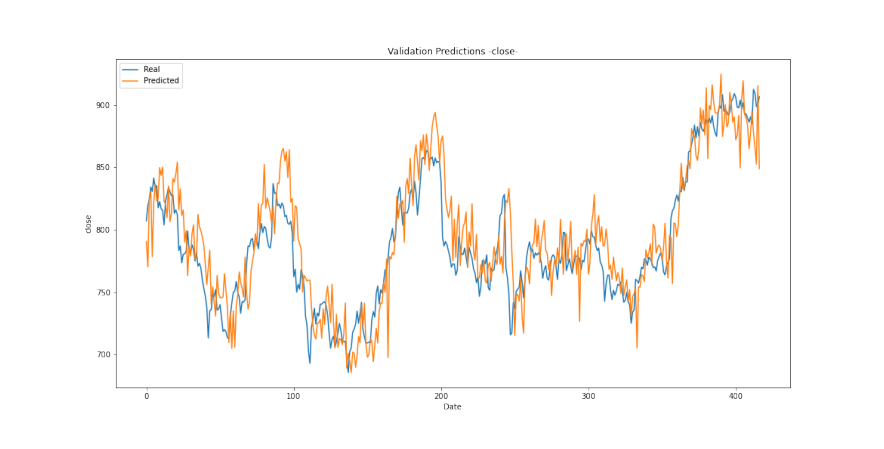

In [25]:
images = []
num_epochs = 79000
for epoch in range(num_epochs):
    if (epoch+1)%evaluation_epoch_num == 0 or epoch == 0 or epoch == (num_epochs-1):
        image_path = os.path.join('./plots_gru_disc/', f'validation_predictions_plt_close_e{epoch+1}.png')
        image = plt.imread(image_path)
        images.append(image)
#%%capture
import matplotlib.animation as animation
from IPython.display import HTML

fig = plt.figure(figsize=(16,8))
plt.axis("off")

all_images = [[plt.imshow(image, animated=True)] for image in images]
plt.rcParams['animation.embed_limit'] = 2**32
ani = animation.ArtistAnimation(fig, all_images, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

KeyError: 'open'

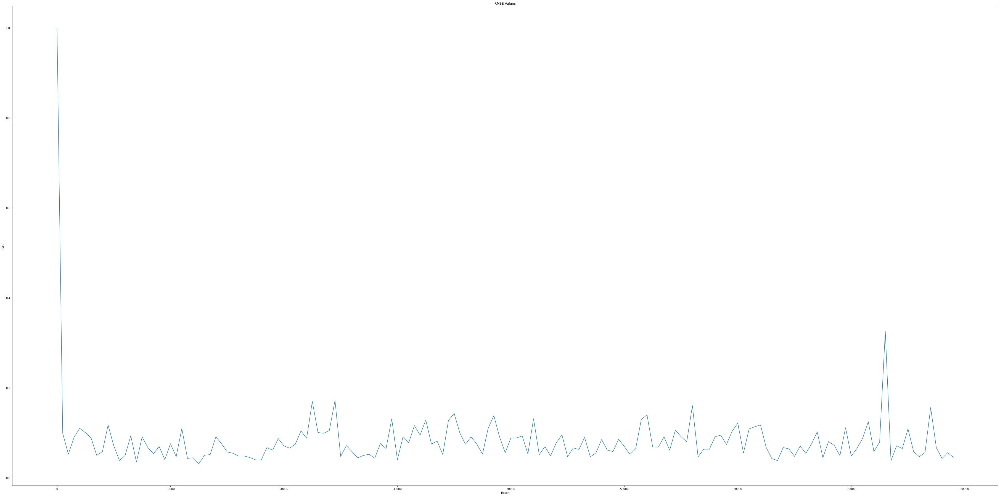

In [24]:
fig = plt.figure(figsize=(64,32))
plt.xlabel("Epoch")
plt.ylabel("RMSE")
plt.title("RMSE Values")
epoch_len = len(evaluation_metrics["rmse_values"][columns_used_in_training[0]])
x = [0] + [i for i in range(evaluation_epoch_num, evaluation_epoch_num*epoch_len, evaluation_epoch_num)]
# plt.ylim(0, 5)
for column in columns_used_in_training:
    y = evaluation_metrics["rmse_values"][column]
    y /= max(y)
    plt.plot(x, y,label=column)
plt.legend()
fig.savefig(f'./plots_gru_disc/rmse_all.png')
plt.show()
plt.close(fig)

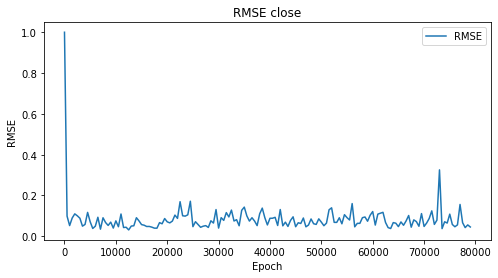

KeyError: 'open'

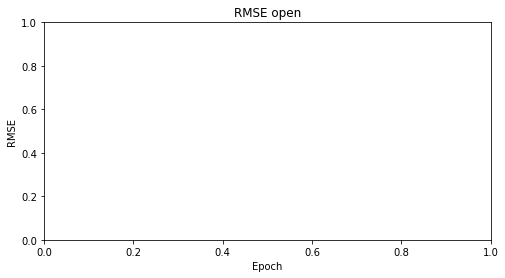

In [26]:
for column in columns_used_in_training:
    fig = plt.figure(figsize=(8,4))
    plt.xlabel("Epoch")
    plt.ylabel("RMSE")
    plt.title(f"RMSE {column}")
    epoch_len = len(evaluation_metrics["rmse_values"][columns_used_in_training[0]])
    x = [0] + [i for i in range(evaluation_epoch_num, evaluation_epoch_num*epoch_len, evaluation_epoch_num)]
    # plt.ylim(0, 5)
    y = evaluation_metrics["rmse_values"][column]
    y /= max(y)
    plt.plot(x, y,label="RMSE")
    plt.legend()
    fig.savefig(f'./plots_gru_disc/rmse_{column}.png')
    plt.show()
    plt.close(fig)

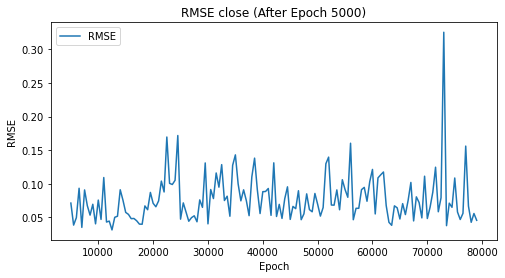

KeyError: 'open'

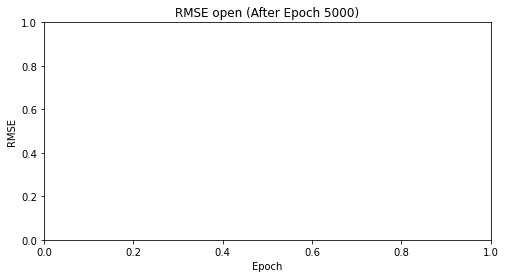

In [27]:
for column in columns_used_in_training:
    fig = plt.figure(figsize=(8,4))
    plt.xlabel("Epoch")
    plt.ylabel("RMSE")
    plt.title(f"RMSE {column} (After Epoch 5000)")
    epoch_len = len(evaluation_metrics["rmse_values"][columns_used_in_training[0]])
    x = [0] + [i for i in range(evaluation_epoch_num, evaluation_epoch_num*epoch_len, evaluation_epoch_num)]
    # plt.ylim(0, 5)
    y = evaluation_metrics["rmse_values"][column]
    y /= max(y)
    plt.plot(x[10:], y[10:],label="RMSE")
    plt.legend()
    fig.savefig(f'./plots_gru_disc/rmse_{column}.png')
    plt.show()
    plt.close(fig)

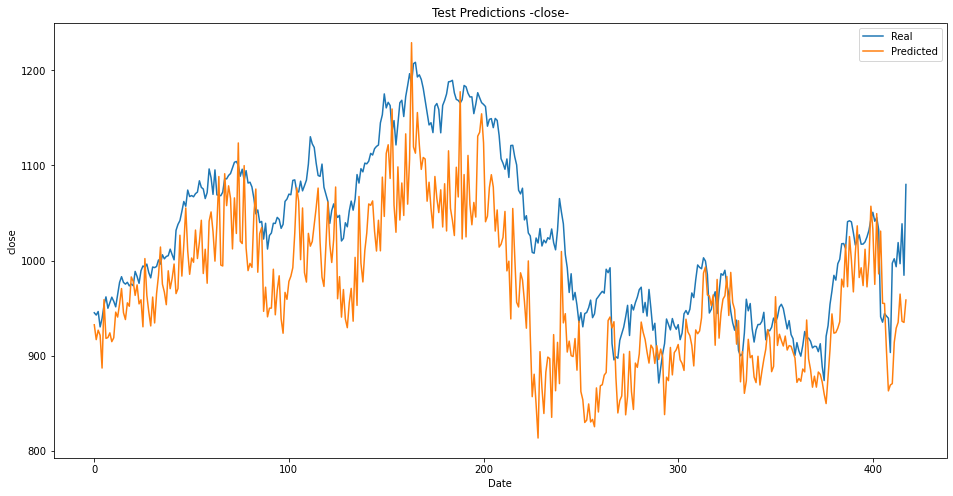

{'close': 72.66972147194635, 'open': 74.957359762037, 'high': 86.0248375851312, 'low': 95.49420324851762, 'CUMLOGRET_1': 0.13491204647820845, 'RSI_14': 11.547312859793852, 'MACD_12_26_9': 4.477619326725757, 'SMA5': 66.19558119348576}


In [28]:
checkpoint = torch.load(os.path.join("./models_gru_disc/","model_epoch_{}.pt".format(best_predictor)))
generator.load_state_dict(checkpoint['generator_model_state_dict'])
rmse_values = model_rmse(generator, test_dataloader, epoch=best_predictor, plot_graph=True, plot_title="Test Predictions", show_preds=True)
print(rmse_values)

In [29]:
best_predictor

7000